In [50]:

import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

import difflib
import warnings

import spotipy
from spotipy.oauth2 import SpotifyClientCredentials

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE

from collections import defaultdict

from scipy.spatial.distance import cdist
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV, GridSearchCV, train_test_split, cross_val_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor

sns.set()
warnings.filterwarnings("ignore")


In [51]:
data = pd.read_csv("./data/data.csv")

In [52]:
data.isnull().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
dtype: int64

In [53]:
data.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653.000000,1.706530e+05,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000
mean,0.528587,1976.787241,0.502115,0.537396,2.309483e+05,0.482389,0.084575,0.167010,5.199844,0.205839,-11.467990,0.706902,31.431794,0.098393,116.861590
std,0.263171,25.917853,0.376032,0.176138,1.261184e+05,0.267646,0.278249,0.313475,3.515094,0.174805,5.697943,0.455184,21.826615,0.162740,30.708533
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.615000,0.000000,11.000000,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.580000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624000e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


Analyze data set 

In [54]:
data['duration_min'] = data['duration_ms']/60000
data['duration_min'] = data['duration_min'].round(1)
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,duration_min
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,13.9
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,3.0
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339,8.3
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109,3.5
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,2.8


In [55]:

data["artists"]=data["artists"].str.replace("[", "")
data["artists"]=data["artists"].str.replace("]", "")
data["artists"]=data["artists"].str.replace("'", "")

data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,duration_min
0,0.0594,1921,0.982,"Sergei Rachmaninoff, James Levine, Berliner Ph...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,13.9
1,0.9630,1921,0.732,Dennis Day,0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,3.0
2,0.0394,1921,0.961,KHP Kridhamardawa Karaton Ngayogyakarta Hadini...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339,8.3
3,0.1650,1921,0.967,Frank Parker,0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109,3.5
4,0.2530,1921,0.957,Phil Regan,0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,2.8


In [56]:
data.duplicated().any().sum() 

0

In [57]:
## lets examine the dataset closely for duplicates
duplicate_names = data[data.duplicated(['name'])] 
# there are tracks with same name 
duplicate_names

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,duration_min
25,0.0731,1921,0.99300,Sergei Rachmaninoff,0.389,218773,0.0880,0,0eQsdik7GTEy7M3UytCbSN,0.527000,1,0.3630,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",0,1921,0.0456,92.867,3.6
39,0.0594,1921,0.98200,"Sergei Rachmaninoff, James Levine, Berliner Ph...",0.279,831667,0.2110,0,1SCWBjhk5WmXPxhDduD3HM,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",1,1921,0.0366,80.954,13.9
67,0.2870,1921,0.98800,"Gaetano Donizetti, Arturo Toscanini",0.341,388867,0.1390,0,2jy7vkWNflSApGQ7b6ziA6,0.114000,2,0.3040,-19.399,1,Overture,0,1921,0.0643,68.031,6.5
84,0.0770,1921,0.99400,"Sergei Rachmaninoff, Ruth Laredo",0.248,117467,0.0876,0,3Jsx93Aim5jr96396tgDt7,0.907000,5,0.1650,-25.786,1,"6 Songs, Op. 38: No. 3, Daisies (Version for P...",0,1921,0.0566,82.025,2.0
87,0.2820,1921,0.98900,"Sergei Rachmaninoff, Ruth Laredo",0.384,221013,0.1710,0,3XooVMkWzhrHdPQyi46sl6,0.820000,7,0.1160,-20.476,0,"10 Préludes, Op. 23: No. 5 in G Minor. Alla ma...",0,1921,0.0319,107.698,3.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170631,0.3270,2020,0.21700,YoungBoy Never Broke Again,0.485,156077,0.8140,1,3qHgGyJY4GpXNOK4WL4NSo,0.000000,9,0.1120,-3.907,1,Red Eye,63,2020-02-21,0.1380,159.894,2.6
170635,0.1580,2020,0.54100,Chris Renzema,0.292,254107,0.3550,0,5XBbvUfLSFAT5Rh8eudY8G,0.000000,5,0.0931,-7.225,1,Springtime,63,2020-04-24,0.0294,71.041,4.2
170640,0.6940,2020,0.06990,"Loud Luxury, Frank Walker, Stephen Puth",0.759,176389,0.8450,0,5seWZTjT0U8a7cy3Y5NJQ9,0.000087,6,0.2150,-6.794,0,Like Gold,69,2020-10-30,0.0421,124.000,2.9
170648,0.6080,2020,0.08460,"Anuel AA, Daddy Yankee, KAROL G, Ozuna, J Balvin",0.786,301714,0.8080,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029,5.0


In [58]:
## examine the dataset for tracks with same name and artists, we can see that the dataset has some duplicate rows
## duplicates were not seen earlier because of a unique id column for each row
duplicate_names_artist = data[data.duplicated(['name', 'artists'])] 
# there are songs with same name and artists
duplicate_names_artist

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,duration_min
25,0.0731,1921,0.9930,Sergei Rachmaninoff,0.389,218773,0.0880,0,0eQsdik7GTEy7M3UytCbSN,0.527000,1,0.3630,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",0,1921,0.0456,92.867,3.6
39,0.0594,1921,0.9820,"Sergei Rachmaninoff, James Levine, Berliner Ph...",0.279,831667,0.2110,0,1SCWBjhk5WmXPxhDduD3HM,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",1,1921,0.0366,80.954,13.9
84,0.0770,1921,0.9940,"Sergei Rachmaninoff, Ruth Laredo",0.248,117467,0.0876,0,3Jsx93Aim5jr96396tgDt7,0.907000,5,0.1650,-25.786,1,"6 Songs, Op. 38: No. 3, Daisies (Version for P...",0,1921,0.0566,82.025,2.0
87,0.2820,1921,0.9890,"Sergei Rachmaninoff, Ruth Laredo",0.384,221013,0.1710,0,3XooVMkWzhrHdPQyi46sl6,0.820000,7,0.1160,-20.476,0,"10 Préludes, Op. 23: No. 5 in G Minor. Alla ma...",0,1921,0.0319,107.698,3.7
104,0.1860,1921,0.9940,"Sergei Rachmaninoff, Ruth Laredo",0.263,132400,0.0536,0,4i1aZH9CQyvsWtOulh6mbF,0.927000,8,0.0980,-28.147,1,"12 Songs, Op. 21: No. 5, Lilacs (Version for P...",0,1921,0.0386,129.365,2.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170603,0.0736,2020,0.6950,Joji,0.484,214558,0.6320,0,5jSBnH9NyaNP5zdSB3pwgu,0.024300,5,0.2090,-6.917,1,Gimme Love,69,2020-09-24,0.0976,126.384,3.6
170607,0.6310,2020,0.1690,"$NOT, Flo Milli",0.844,125853,0.7200,1,3PXi72ZtSqx1PZc40KS0Qj,0.000000,1,0.0797,-7.418,0,Mean,65,2020-10-30,0.3000,99.917,2.1
170624,0.6970,2020,0.0529,Ozuna,0.735,217240,0.7910,0,5Jm4w8jmPEBTLjI9vH4fXo,0.000146,6,0.1450,-4.462,1,Caramelo,80,2020-09-04,0.0679,168.087,3.6
170626,0.1550,2020,0.0627,Cookiee Kawaii,0.778,84000,0.5760,1,4ZAQiu61otvHVveuTsPAUr,0.004400,10,0.1160,-8.698,1,Vibe (If I Back It Up),68,2020-08-28,0.3010,80.027,1.4


In [59]:
## here we drop the 'id' column and release_date column (since we have the year column, it is redundant information)
data = data.drop(labels=['id', 'release_date'], axis=1)
data.shape

(170653, 18)

In [60]:
## check duplicates
data.duplicated().sum()

565

In [61]:
## drop the duplicates
data = data[~data.duplicated()==1]
data.shape

(170088, 18)

In [62]:
#Drop the duration_ms column since we have the duration in minutes
data.drop(['duration_ms'],inplace=True,axis=1)

<Axes: xlabel='key', ylabel='Density'>

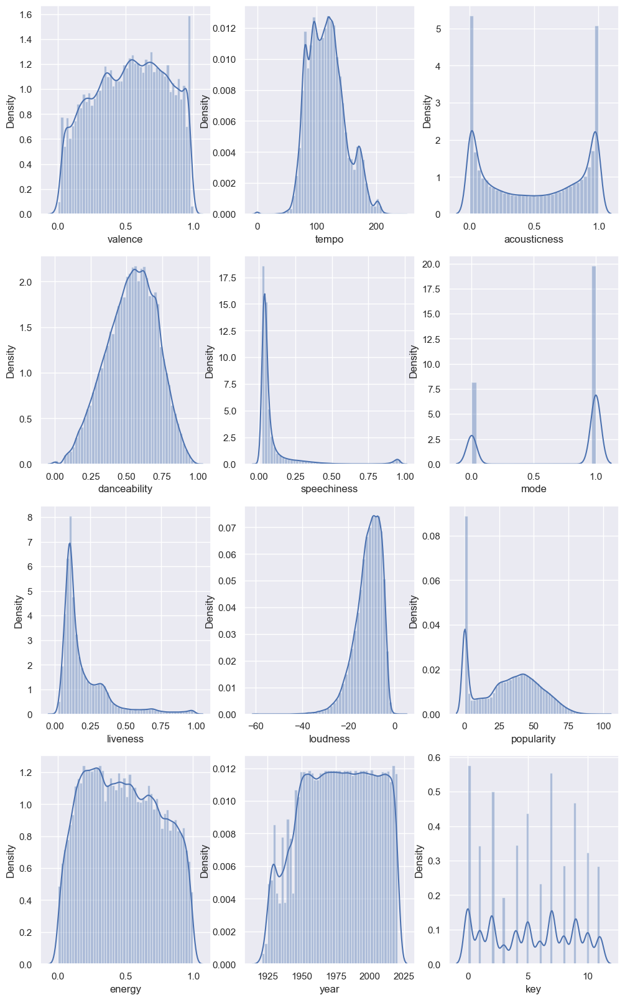

In [63]:
fig,ax = plt.subplots(4,3,figsize=(12,20))
sns.set(font_scale = 1)
sns.distplot(data['valence'],ax=ax[0,0])
sns.distplot(data['tempo'],ax=ax[0,1])
sns.distplot(data['acousticness'],ax=ax[0,2])
sns.distplot(data['danceability'],ax=ax[1,0])
sns.distplot(data['speechiness'],ax=ax[1,1])
sns.distplot(data['mode'],ax=ax[1,2])
sns.distplot(data['liveness'],ax=ax[2,0])
sns.distplot(data['loudness'],ax=ax[2,1])
sns.distplot(data['popularity'],ax=ax[2,2])
sns.distplot(data['energy'],ax=ax[3,0])
sns.distplot(data['year'],ax=ax[3,1])
sns.distplot(data['key'],ax=ax[3,2])

In [64]:
data.corr()

,valence,year,acousticness,danceability,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,duration_min
valence,1.000000,-0.032111,-0.181672,0.557851,0.351917,-0.019356,-0.195858,0.028675,0.003380,0.310968,0.015664,0.010775,0.045745,0.170748,-0.191677
year,-0.032111,1.000000,-0.612423,0.185450,0.528146,0.220400,-0.268217,0.007848,-0.058052,0.485107,-0.032518,0.862780,-0.169525,0.139560,0.080133
acousticness,-0.181672,-0.612423,1.000000,-0.264607,-0.748522,-0.245585,0.326904,-0.020721,-0.024062,-0.560167,0.047358,-0.571578,-0.043163,-0.206107,-0.076622
danceability,0.557851,0.185450,-0.264607,1.000000,0.219468,0.241508,-0.276002,0.024701,-0.100739,0.282517,-0.046160,0.197104,0.235150,0.000324,-0.139885
energy,0.351917,0.528146,-0.748522,0.219468,1.000000,0.132110,-0.277925,0.028107,0.125973,0.781683,-0.039313,0.483281,-0.071713,0.250084,0.042339
explicit,-0.019356,0.220400,-0.245585,0.241508,0.132110,1.000000,-0.140448,0.005487,0.039603,0.139723,-0.079145,0.190644,0.414139,0.011640,-0.049140
instrumentalness,-0.195858,-0.268217,0.326904,-0.276002,-0.277925,-0.140448,1.000000,-0.014760,-0.046646,-0.404905,-0.036699,-0.293230,-0.120983,-0.103701,0.085506
key,0.028675,0.007848,-0.020721,0.024701,0.028107,0.005487,-0.014760,1.000000,0.000315,0.017976,-0.116508,0.008083,0.023928,0.002996,-0.004153
liveness,0.003380,-0.058052,-0.024062,-0.100739,0.125973,0.039603,-0.046646,0.000315,1.000000,0.055762,0.002603,-0.077347,0.134644,0.007465,0.047409
loudness,0.310968,0.485107,-0.560167,0.282517,0.781683,0.139723,-0.404905,0.017976,0.055762,1.000000,-0.010691,0.454867,-0.141202,0.209018,-0.003609


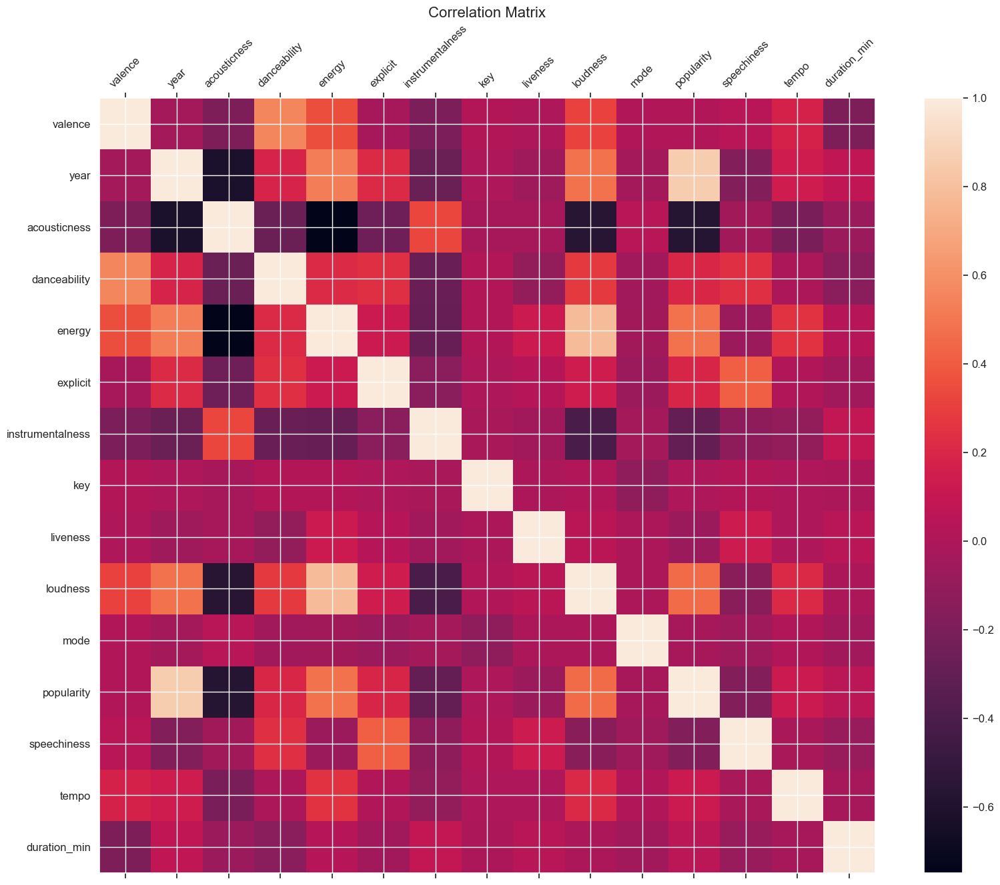

In [65]:
## visualization of the correlation matrix
f = plt.figure(figsize=(19, 15))
plt.matshow(data.corr(), fignum=f.number)
plt.xticks(range(data.select_dtypes(['number']).shape[1]), data.select_dtypes(['number']).columns, fontsize=12, rotation=45)
plt.yticks(range(data.select_dtypes(['number']).shape[1]), data.select_dtypes(['number']).columns, fontsize=12)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=12)
plt.title('Correlation Matrix', fontsize=16);

In [66]:
# get top ten tracks (by popularity)
top_ten_tracks = data.groupby("name")['popularity'].mean().sort_values(ascending=False).head(10)
top_ten_tracks.head(10)

name
Dakiti                             100.0
Mood (feat. iann dior)              99.0
Blinding Lights                     96.0
What You Know Bout Love             96.0
WAP (feat. Megan Thee Stallion)     96.0
you broke me first                  95.0
Holy (feat. Chance The Rapper)      95.0
Lonely (with benny blanco)          95.0
Head & Heart (feat. MNEK)           94.0
Relación - Remix                    94.0
Name: popularity, dtype: float64

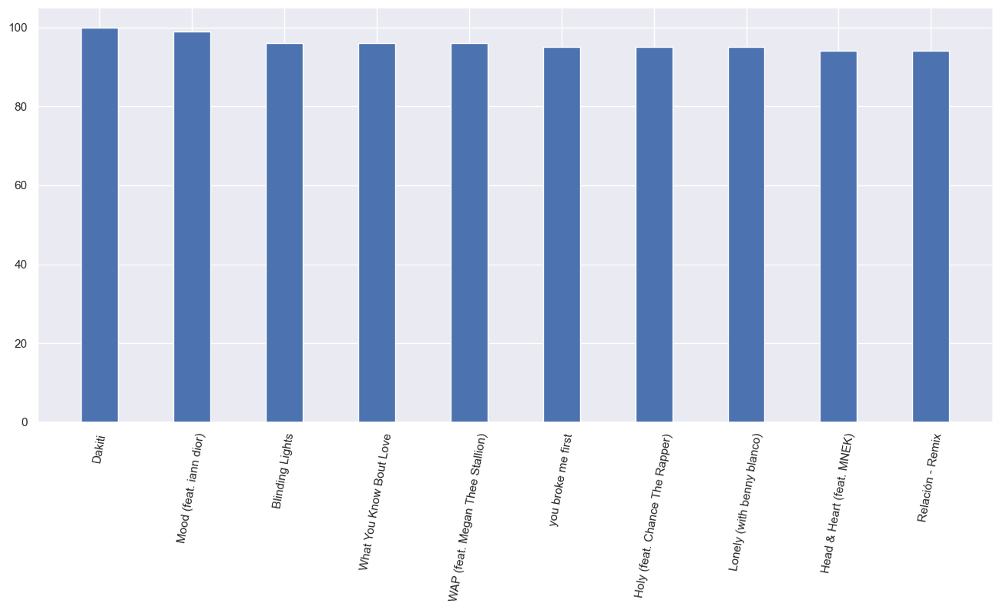

In [67]:
# closer look at the popular tracks
fig, axis = plt.subplots(figsize = (16,7))
axis = plt.bar(top_ten_tracks.index, top_ten_tracks, width=0.4)
plt.xticks(rotation = 80);

In [68]:
# Lets analyse most popular artists, The Beatles are the most popular artists
top_ten_artists = data.groupby("artists")['popularity'].sum().sort_values(ascending=False).head(10)
top_ten_artists.head(10)

artists
The Beatles           19218
Frank Sinatra         17987
Elvis Presley         17188
The Rolling Stones    16477
Fleetwood Mac         15640
Bob Dylan             14570
Led Zeppelin          13437
Queen                 13202
Johnny Cash           12802
The Beach Boys        12216
Name: popularity, dtype: int64

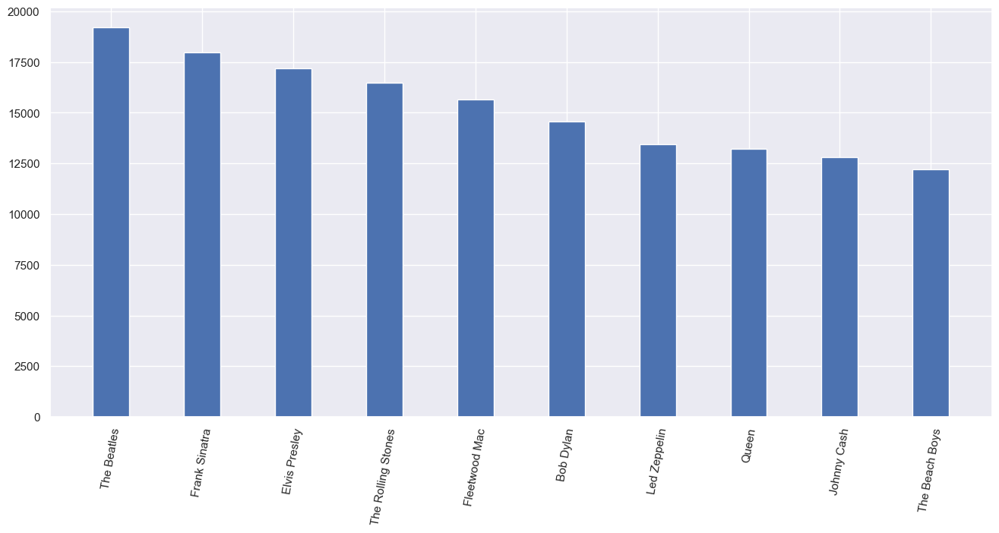

In [69]:
# closer look at popularity
fig, axis = plt.subplots(figsize = (16,7))
axis = plt.bar(top_ten_artists.index, top_ten_artists, width=0.4)
plt.xticks(rotation = 80);

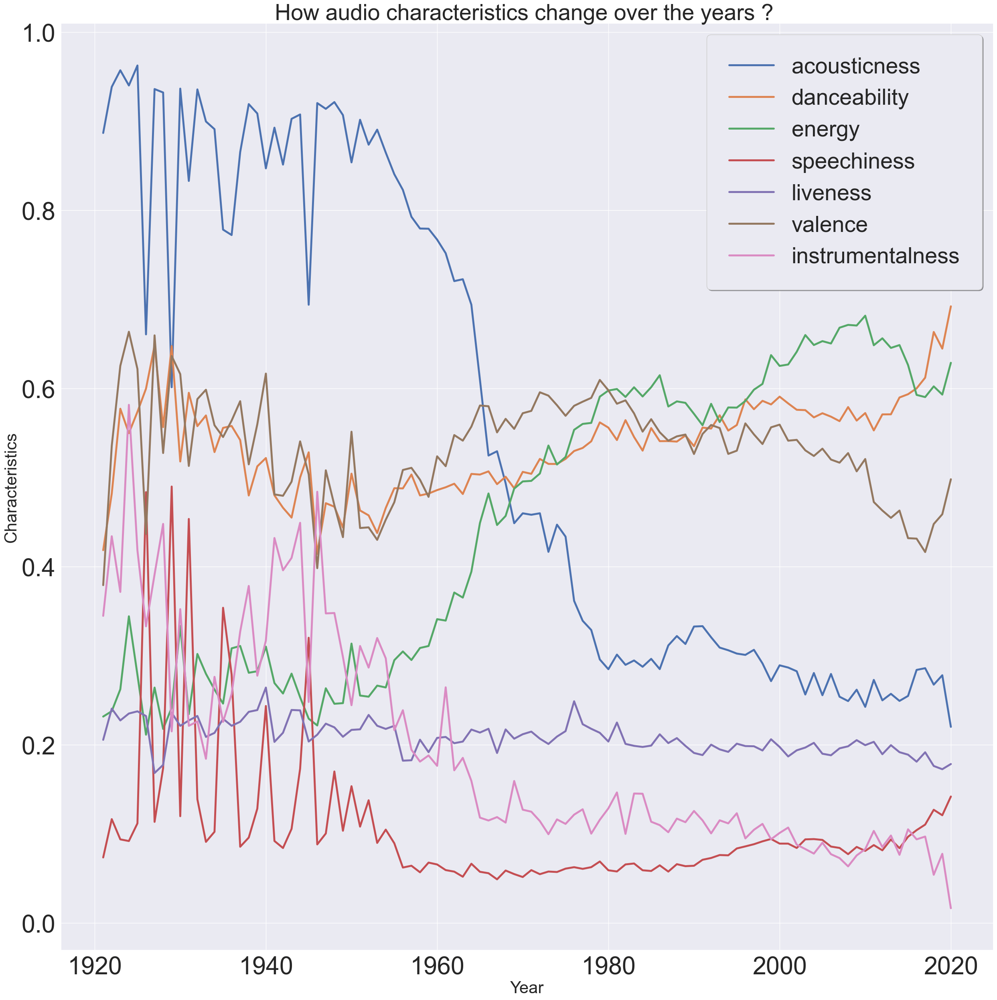

In [70]:
### here we will look at audio characterstics evolution over the years

columns = ["acousticness","danceability","energy","speechiness","liveness","valence", "instrumentalness"]

plt.figure(figsize=(30,30))
sns.set(font_scale=4) 
for c in columns:
    x = data.groupby('year')[c].mean()
    sns.lineplot(x,linewidth = 3.5,label=c)
plt.title('How audio characteristics change over the years ? ', fontsize=40)
plt.xlabel('Year',fontsize=30)
plt.ylabel('Characteristics',fontsize=30)
plt.legend(fancybox=True, framealpha=1, shadow=True, borderpad=1, prop={'size': 40}, loc = 'upper right')
plt.show()

<Axes: xlabel='decade', ylabel='count'>

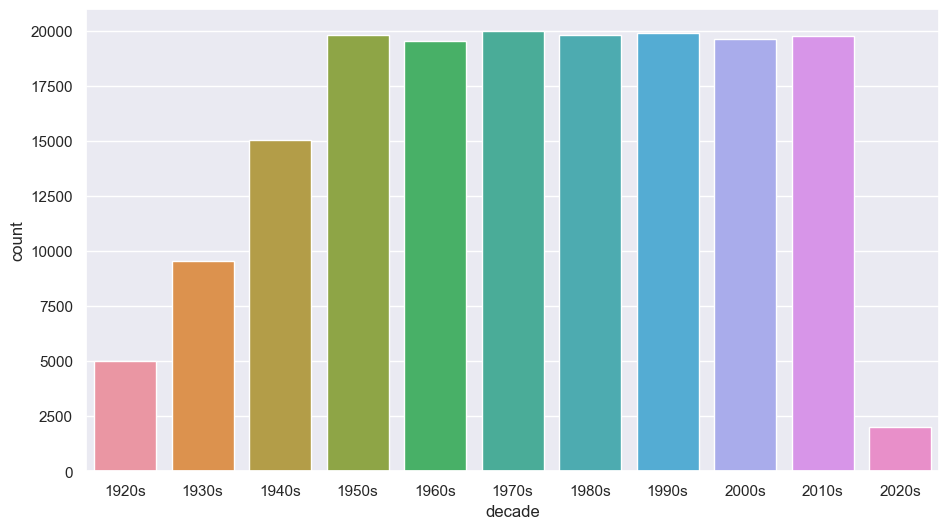

In [71]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(x=data['decade'])

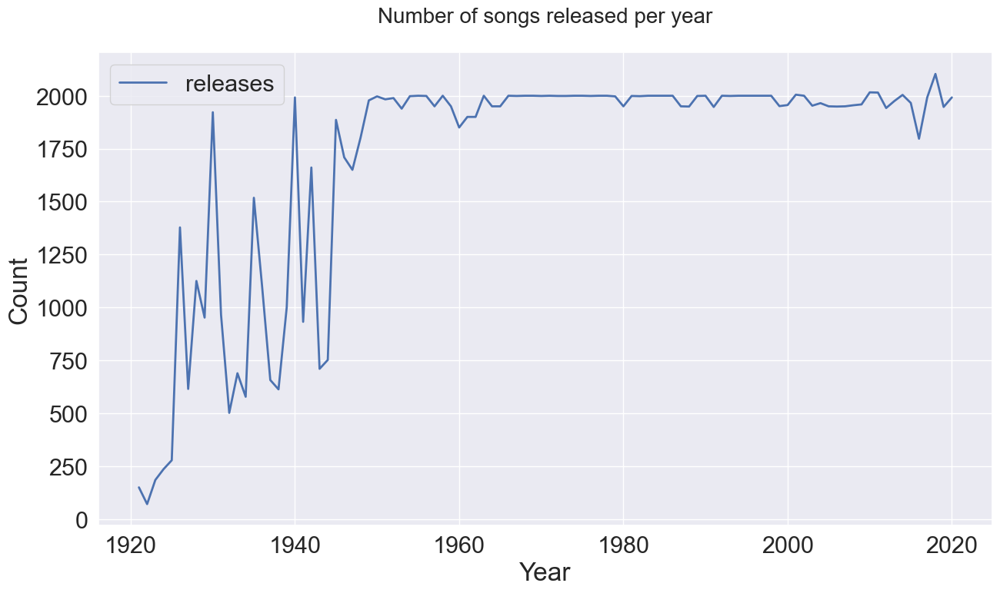

In [72]:
# numbe of song releases per year
number_of_releases = pd.DataFrame(data['year'].value_counts())
number_of_releases.rename({'year': 'releases'}, axis=1, inplace=True)
number_of_releases = number_of_releases.sort_index()
sns.set(font_scale=2) 
ax=number_of_releases.plot(kind='line',figsize=(15,8), linewidth=2)
plt.title("Number of songs released per year",y=1.05,fontsize=20)
plt.xlabel('Year')
plt.ylabel('Count')
ax.axes.get_xaxis().set_visible(True)

In [73]:
# which features are highly correlated with popularity?
data.corr()['popularity']

valence             0.010775
year                0.862780
acousticness       -0.571578
danceability        0.197104
energy              0.483281
explicit            0.190644
instrumentalness   -0.293230
key                 0.008083
liveness           -0.077347
loudness            0.454867
mode               -0.029372
popularity          1.000000
speechiness        -0.173675
tempo               0.132334
duration_min        0.059721
Name: popularity, dtype: float64

In [74]:
# feature selection based on correlation
#Correlation with the output variable
cor_target = abs(data.corr()["popularity"])
#Selecting highly correlated features
relevant_features = cor_target[cor_target> 0.1]
feature_cols = relevant_features.keys().to_list()
feature_cols

['year',
 'acousticness',
 'danceability',
 'energy',
 'explicit',
 'instrumentalness',
 'loudness',
 'popularity',
 'speechiness',
 'tempo']

In [75]:
## preparing a dataset for training
df = data[feature_cols] # get a dataset with only selected features
df = df[~df.duplicated()==1]
df.head()

,year,acousticness,danceability,energy,explicit,instrumentalness,loudness,popularity,speechiness,tempo
0,1921,0.982,0.279,0.211,0,0.878000,-20.096,4,0.0366,80.954
1,1921,0.732,0.819,0.341,0,0.000000,-12.441,5,0.4150,60.936
2,1921,0.961,0.328,0.166,0,0.913000,-14.850,5,0.0339,110.339
3,1921,0.967,0.275,0.309,0,0.000028,-9.316,3,0.0354,100.109
4,1921,0.957,0.418,0.193,0,0.000002,-10.096,2,0.0380,101.665


In [76]:
#Split the data to train and test using sklearn 
# target column is popularity and we use 80% - 20% split
X_train, X_test, y_train, y_test = train_test_split(df.drop('popularity', axis=1), df['popularity'], test_size = 0.2, random_state = 42)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(135920, 9) (33980, 9) (135920,) (33980,)


In [77]:
# A function to transform tempo using either median or mean value
def tempoTransformer(X, method):
    '''
    Input: 
    X - dataset
    method - either median or mean
    Output:
    A dataset with zero tempo values transformed by the method.
    '''
    if method == 'median':
        X.loc[X['tempo']==0, 'tempo'] = X.loc[X['tempo']>0, 'tempo'].median()
    elif method == 'mean':
        X.loc[X['tempo']==0, 'tempo'] = X.loc[X['tempo']>0, 'tempo'].mean()
    else:
        raise Exception("method is either 'median' or 'mean'")
    return X

#Apply Tempo Transformer Train & Test set
X_train = tempoTransformer(X_train, "median")
X_test = tempoTransformer(X_test, "median")

In [78]:
## Apply minmaxscaler to columns in training data that are not in (0,1) range
scaler = MinMaxScaler()
cols = ['loudness','tempo', 'year']
X_train[cols] = scaler.fit_transform(X_train[cols])
X_test[cols] = scaler.fit_transform(X_test[cols])

In [79]:
# feature transformation
df['tempo'].describe() # it seems that tempo of zero should be replaced, since tempo in (BPM) cannot be zero.

count    169900.000000
mean        116.910674
std          30.696871
min           0.000000
25%          93.491000
50%         114.787000
75%         135.596000
max         243.507000
Name: tempo, dtype: float64

In [80]:
# normalize the target (popularity) to the range of 0 --- 1
y_train = y_train / 100
y_test = y_test / 100

In [81]:
## Lets examine the training set one more time to see the columns are as expected
X_train

,year,acousticness,danceability,energy,explicit,instrumentalness,loudness,speechiness,tempo
66286,0.555556,0.79200,0.495,0.269,0,0.000004,0.719035,0.0280,0.216042
71293,0.808081,0.10900,0.543,0.770,1,0.000205,0.841594,0.0662,0.623840
27788,0.454545,0.94900,0.581,0.391,0,0.000000,0.725190,0.5050,0.383091
97694,0.444444,0.98800,0.425,0.449,0,0.068400,0.802537,0.0655,0.447076
109887,0.242424,0.08090,0.646,0.162,1,0.005080,0.596523,0.9150,0.280339
...,...,...,...,...,...,...,...,...,...
120340,0.767677,0.00001,0.143,0.992,0,0.006710,0.844288,0.1880,0.797214
104065,0.757576,0.09010,0.902,0.969,0,0.002910,0.846292,0.0471,0.416119
132476,0.575758,0.29000,0.326,0.632,0,0.913000,0.840357,0.0404,0.280495
147512,0.585859,0.09050,0.651,0.880,0,0.465000,0.869251,0.0486,0.343416


In [82]:
# grid search CV to get the best parameters for the decision tree model
# initialize number of features and samples
# commented this cell since it takes a while to run, at lease on my laptop
no_features = df.shape[1] - 1
no_samples = df.shape[0]
# define grid parameter list 
grid = GridSearchCV(DecisionTreeRegressor(random_state=1), cv=5, n_jobs=-1, verbose=5,
                    param_grid ={
                    'max_depth': [None,5,7,9,11,15],
                    'max_leaf_nodes': [5,20,40,80,120,160,200],
                    'max_features': ['sqrt', 'auto', 'log2', 0.3,0.5,0.7, no_features//2, no_features//3],
                    'min_samples_split': [2],
                    'min_samples_leaf':[1]},
                    )
 
grid.fit(X_train, y_train)
print('Training r^2 Score : %.3f'%grid.best_estimator_.score(X_train, y_train))
print('Test r^2 Score : %.3f'%grid.best_estimator_.score(X_test,y_test))
print('Best r^2 score by the grid search : %.3f'%grid.best_score_)
print('Best parameters from the grid search : ',grid.best_params_)

Fitting 5 folds for each of 336 candidates, totalling 1680 fits


[CV 5/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.524 total time=   0.7s
[CV 2/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.7s
[CV 3/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.529 total time=   0.7s
[CV 4/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.524 total time=   0.7s
[CV 1/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.6s
[CV 5/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.661 total time=   0.8s
[CV 4/5] END max_depth=None, max_features=sqrt, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.666 total time=   0.8s
[CV 1/5] END max_depth=No

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=None, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.764 total time=   0.3s
[CV 2/5] END max_depth=None, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.761 total time=   0.3s
[CV 3/5] END max_depth=None, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.766 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 4/5] END max_depth=None, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.759 total time=   0.3s
[CV 5/5] END max_depth=None, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.748 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=None, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.4s
[CV 2/5] END max_depth=None, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.4s
[CV 3/5] END max_depth=None, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.4s
[CV 4/5] END max_depth=None, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.788 total time=   0.4s
[CV 5/5] END max_depth=None, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.775 total time=   0.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=None, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.5s
[CV 2/5] END max_depth=None, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 3/5] END max_depth=None, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.5s
[CV 4/5] END max_depth=None, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.6s
[CV 5/5] END max_depth=None, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.779 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=None, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 2/5] END max_depth=None, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   0.8s
[CV 3/5] END max_depth=None, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.9s
[CV 4/5] END max_depth=None, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.9s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=None, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.782 total time=   1.0s
[CV 1/5] END max_depth=None, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   1.0s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 2/5] END max_depth=None, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.1s
[CV 3/5] END max_depth=None, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.1s
[CV 4/5] END max_depth=None, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   1.1s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=None, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.783 total time=   1.1s
[CV 1/5] END max_depth=None, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.1s
[CV 2/5] END max_depth=None, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.2s
[CV 3/5] END max_depth=None, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.1s
[CV 1/5] END max_depth=None, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 4/5] END max_depth=None, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   1.1s
[CV 2/5] END max_depth=None, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 5/5] END max_

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.764 total time=   0.3s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.761 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.766 total time=   0.4s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.759 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.748 total time=   0.5s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   0.7s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.7s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.789 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.786 total time=   0.7s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.775 total time=   0.7s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.7s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.6s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.6s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.787 total time=   0.6s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.776 total time=   0.6s
[CV 1/5] END max_depth=5, max_features=au

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.5s
[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.787 total time=   0.5s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.776 total time=   0.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.5s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.787 total time=   0.6s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.776 total time=   0.6s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.6s
[CV 3/5] END max_depth=5, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 4/5] END max_depth=5, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.787 total time=   0.7s
[CV 5/5] END max_depth=5, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.776 total time=   0.7s
[CV 2/5] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 1/5] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 3/5] END max_depth=5, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.529 total time=   0.2s
[CV 1/5] END max_depth=5, max_features=auto, max_leaf_nodes=200, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.6s
[CV 2/5] END max_depth=5, max_features=auto, max_leaf_nodes=200, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.6s
[CV 3/5] END max_depth=5, max_features=a

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.764 total time=   0.2s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.761 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.766 total time=   0.3s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.759 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.748 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.4s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.6s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.788 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.774 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   0.8s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.8s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.7s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.779 total time=   0.8s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.8s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.8s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.8s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   0.9s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.780 total time=   0.9s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.9s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.0s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.1s
[CV 4/5] END max_depth=7, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   1.1s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.780 total time=   1.2s
[CV 1/5] END max_depth=7, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.2s
[CV 2/5] END max_depth=7, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.2s
[CV 3/5] END max_depth=7, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.2s
[CV 5/5] END max_depth=7, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.780 total time=   1.1s
[CV 1/5] END max_depth=7, max_feat

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=9, max_features=sqrt, max_leaf_nodes=200, min_samples_leaf=1, min_samples_split=2;, score=0.757 total time=   0.4s
[CV 4/5] END max_depth=9, max_features=sqrt, max_leaf_nodes=200, min_samples_leaf=1, min_samples_split=2;, score=0.752 total time=   0.4s
[CV 5/5] END max_depth=9, max_features=sqrt, max_leaf_nodes=200, min_samples_leaf=1, min_samples_split=2;, score=0.727 total time=   0.3s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.764 total time=   0.4s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.761 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.766 total time=   0.3s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.759 total time=   0.3s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.748 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.4s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.5s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.788 total time=   0.4s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.775 total time=   0.4s
[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.5s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.5s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.778 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.798 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.8s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   0.9s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   1.1s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.782 total time=   1.2s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.4s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   1.3s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   1.4s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.4s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.783 total time=   1.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=9, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.4s
[CV 3/5] END max_depth=9, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.4s
[CV 2/5] END max_depth=9, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.4s
[CV 4/5] END max_depth=9, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   1.3s
[CV 1/5] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 2/5] END max_depth=9, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 5/5] END max_depth=9, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.783 total time=   1.2s
[CV 1/5] END max_depth=9, max_features

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 1/5] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.764 total time=   0.3s
[CV 2/5] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.761 total time=   0.3s
[CV 3/5] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.766 total time=   0.3s
[CV 4/5] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.759 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 5/5] END max_depth=11, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.748 total time=   0.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 1/5] END max_depth=11, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.5s
[CV 2/5] END max_depth=11, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.6s
[CV 3/5] END max_depth=11, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 4/5] END max_depth=11, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.788 total time=   1.1s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=11, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.775 total time=   1.3s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.5s
[CV 3/5] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.5s
[CV 2/5] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.6s
[CV 4/5] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   1.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 5/5] END max_depth=11, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.779 total time=   1.5s
[CV 1/5] END max_depth=11, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.798 total time=   1.7s

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(



[CV 2/5] END max_depth=11, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.6s
[CV 3/5] END max_depth=11, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   1.5s
[CV 4/5] END max_depth=11, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   1.5s
[CV 5/5] END max_depth=11, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.783 total time=   1.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=11, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 2/5] END max_depth=11, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=11, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.7s
[CV 4/5] END max_depth=11, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   1.7s
[CV 5/5] END max_depth=11, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.785 total time=   1.8s
[CV 1/5] END max_depth=11, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.9s
[CV 2/5] END max_depth=11, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.8s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=11, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   1.6s
[CV 4/5] END max_depth=11, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   1.6s
[CV 2/5] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.3s
[CV 1/5] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.3s
[CV 4/5] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.524 total time=   0.3s
[CV 3/5] END max_depth=11, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.529 total time=   0.3s
[CV 5/5] END max_depth=11, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.786 total time=   1.6s
[CV 5/5] END max_depth=11, max_feat

/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=15, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.764 total time=   0.3s
[CV 2/5] END max_depth=15, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.761 total time=   0.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 3/5] END max_depth=15, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.766 total time=   0.4s
[CV 4/5] END max_depth=15, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.759 total time=   0.4s
[CV 5/5] END max_depth=15, max_features=auto, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.748 total time=   0.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 2/5] END max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.790 total time=   0.6s
[CV 1/5] END max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.6s
[CV 3/5] END max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 4/5] END max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.788 total time=   0.5s
[CV 5/5] END max_depth=15, max_features=auto, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=2;, score=0.775 total time=   0.5s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.6s
[CV 2/5] END max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   0.6s
[CV 4/5] END max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.6s
[CV 5/5] END max_depth=15, max_features=auto, max_leaf_nodes=40, min_samples_leaf=1, min_samples_split=2;, score=0.779 total time=   0.6s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 1/5] END max_depth=15, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   0.7s
[CV 2/5] END max_depth=15, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 3/5] END max_depth=15, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.794 total time=   0.7s
[CV 4/5] END max_depth=15, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   0.7s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past beha

[CV 5/5] END max_depth=15, max_features=auto, max_leaf_nodes=80, min_samples_leaf=1, min_samples_split=2;, score=0.782 total time=   1.0s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 1/5] END max_depth=15, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.795 total time=   1.2s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 2/5] END max_depth=15, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.797 total time=   1.4s
[CV 3/5] END max_depth=15, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.4s
[CV 4/5] END max_depth=15, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.792 total time=   1.4s


/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/sengayireprince/anaconda3/lib/python3.10/site-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(


[CV 5/5] END max_depth=15, max_features=auto, max_leaf_nodes=120, min_samples_leaf=1, min_samples_split=2;, score=0.783 total time=   1.5s
[CV 1/5] END max_depth=15, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.5s
[CV 1/5] END max_depth=15, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 2/5] END max_depth=15, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.796 total time=   1.4s
[CV 3/5] END max_depth=15, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.793 total time=   1.4s
[CV 2/5] END max_depth=15, max_features=log2, max_leaf_nodes=5, min_samples_leaf=1, min_samples_split=2;, score=0.525 total time=   0.2s
[CV 4/5] END max_depth=15, max_features=auto, max_leaf_nodes=160, min_samples_leaf=1, min_samples_split=2;, score=0.791 total time=   1.3s
[CV 5/5] END max_depth=15, max_

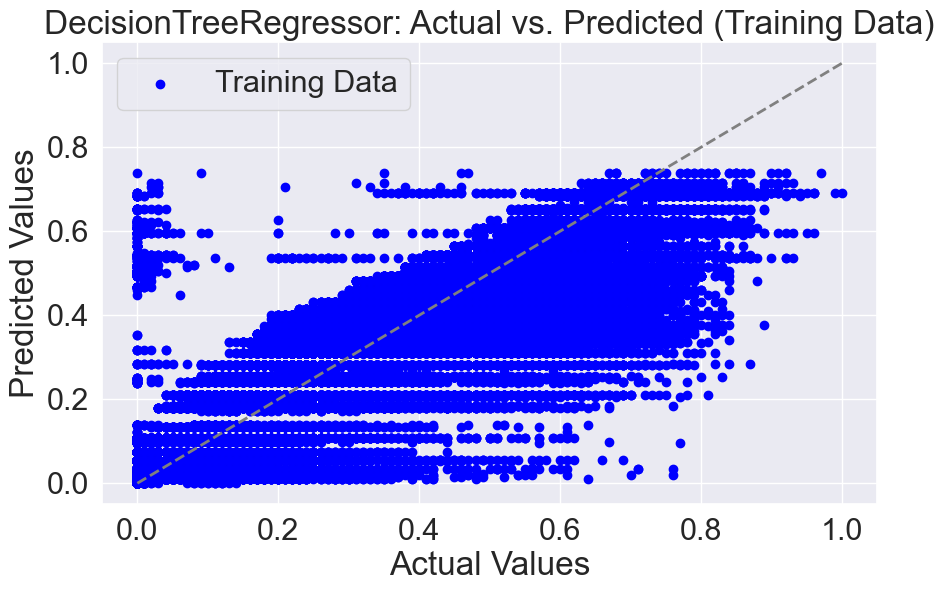

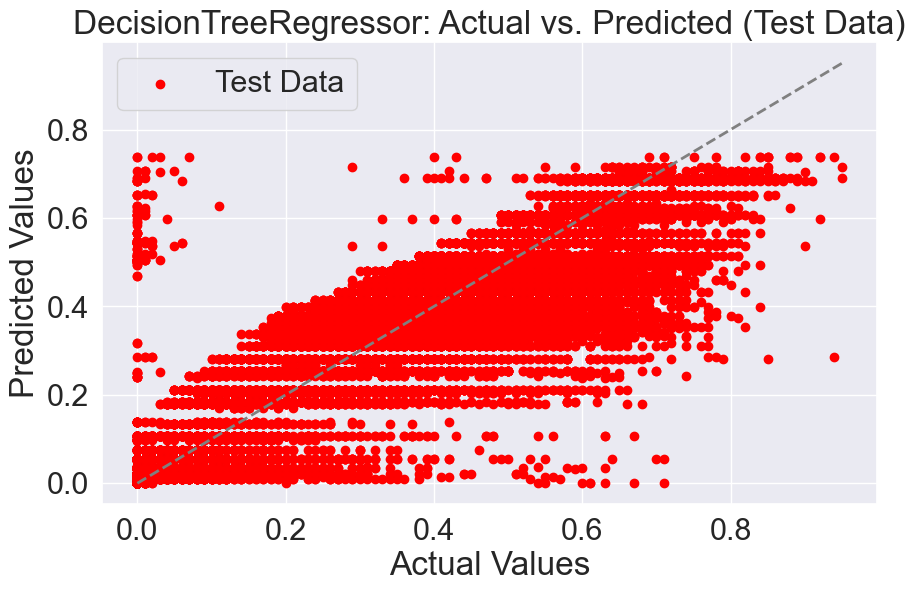

Mean absolute error of this model: 0.069
r2 score for training data: 0.802
r2 score for test data: 0.797


In [83]:
# Decision tree model with tuned hyperparameters using GridSearchCV

dec_tree_tuned = DecisionTreeRegressor(max_depth=11, max_features='auto', 
                                  min_samples_leaf=1, min_samples_split=2, max_leaf_nodes=120, random_state=1)
dec_tree_tuned.fit(X_train,y_train)
y_train_pred = dec_tree_tuned.predict(X_train)
y_test_pred = dec_tree_tuned.predict(X_test)

# Plotting predictions vs. actual values for training data
plt.figure(figsize=(10, 6))
plt.scatter(y_train, y_train_pred, color='blue', label='Training Data')
plt.plot([min(y_train), max(y_train)], [min(y_train), max(y_train)], linestyle='--', color='gray', linewidth=2)
plt.title('DecisionTreeRegressor: Actual vs. Predicted (Training Data)')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.show()

# Plotting predictions vs. actual values for test data
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_test_pred, color='red', label='Test Data')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], linestyle='--', color='gray', linewidth=2)
plt.title('DecisionTreeRegressor: Actual vs. Predicted (Test Data)')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.show()

mae_tuned = mean_absolute_error(y_test, y_test_pred)
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)
print(f'Mean absolute error of this model: {mae_tuned:.3f}')
print(f'r2 score for training data: {r2_train:.3f}')
print(f'r2 score for test data: {r2_test:.3f}')

In [84]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [85]:
# Visualizing the Clusters with PCA
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [88]:
sp = spotipy.Spotify(
  auth_manager=SpotifyClientCredentials(
    client_id=os.environ["SPOTIFY_CLIENT_ID"],
    client_secret=os.environ["SPOTIFY_CLIENT_SECRET"]))

In [89]:
def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_min'] = [results['duration_ms']/60000]
    data['duration_min'] = data['duration_min'].round(1)
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)


In [90]:
def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])

In [91]:
def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

In [92]:
def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict

In [93]:
def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [94]:
recommend_songs([{'name': "what's luv", 'year': 2001 }],  data)

[{'name': "What's Luv? (feat. Ja-Rule & Ashanti)",
  'year': 2001,
  'artists': 'Fat Joe, Ja Rule, Ashanti'},
 {'name': 'Remember the Name (feat. Styles of Beyond)',
  'year': 2005,
  'artists': 'Fort Minor, Styles Of Beyond'},
 {'name': 'me & ur ghost', 'year': 2020, 'artists': 'blackbear'},
 {'name': "Ain't No Fun (If the Homies Cant Have None) (feat. Nate Dogg, Warren G & Kurupt)",
  'year': 1993,
  'artists': 'Snoop Dogg, Kurupt, Warren G, Nate Dogg'},
 {'name': 'Ride Wit Me', 'year': 2000, 'artists': 'Nelly, City Spud'},
 {'name': 'How Do U Want It', 'year': 1998, 'artists': '2Pac, K-Ci & JoJo'},
 {'name': 'How Do You Want It (ft. KC, Jojo)',
  'year': 1996,
  'artists': '2Pac, Jojo, KC'},
 {'name': 'Dangerous', 'year': 2008, 'artists': 'Kardinal Offishall, Akon'},
 {'name': 'Give It To Me',
  'year': 2007,
  'artists': 'Timbaland, Justin Timberlake, Nelly Furtado'},
 {'name': 'Oh Boy', 'year': 2002, 'artists': 'Cam’ron, Juelz Santana'}]